# Processamento de Imagem Digital

## Trabalho 1

### Introdução

O trabalho tem por objetivo implementar técnicas de esteganografia em imagens digitais.

A esteganografia é uma prática milenar utilizada para ocultar informações de modo a transmitir mensagens de maneira segura. Existem relatos da utilização de mensagens talhadas em madeira cobertas por cera na grácia antiga, utilização de tintas invísiveis que apenas se tornam visíveis sob um tipo de luz na segunda guerra mundial e, mais recentemente, em arquivos digitais.

Historicamente tal técnica se tornou comum por possibilitar a transmissão de mensagens sem conhecimento de um interceptador, mas seu uso para outros fins como inclusão de marcas d'agua para verificação de direitos autorais se popularizou gradualmente. Atualmente, é possível até mesmo implantar comportamentos ocultos em redes neurais durante o treinamento, de modo que dadas duas imagens humanamente indistinguíveis, apenas uma ativa tal comportamento.

### Racional

Imagens digitais costumam conter uma quantidade alta de informação. Uma simples imagem de 512x512 pixels em RGB em formato png pode ter mais de 600KB. Desse modo, esconder mensagens é bastante viável.

Por exemplo, podemos alterar todos os valores dos planos de bits menos significativos de cada pixel de uma imagens sem ter um efeito humanamente perceptível:

In [ ]:
# Conetando ao google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install bitstring

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 964.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 288.3/288.3 kB 4.2 MB/s eta 0:00:00


In [ ]:
# Importando pacotes que serão utilizados
import cv2
import numpy as np
import numpy.typing as npt
from bitstring import BitArray
from google.colab.patches import cv2_imshow

In [ ]:
image = cv2.imread("/content/drive/MyDrive/MC920/T1/baboon.png", cv2.IMREAD_COLOR) # Carrega imagem do drive

print(f"Image shape: {image.shape}")
print(f"Image dtype: {image.dtype}")

Image shape: (512, 512, 3)
Image dtype: uint8


Primeiro, importamos uma imagem exemplo que tem 512x512 pixels com 3 canais para cores RGB em formato png.

Em seguida, iremos utilizar mascaras de bits para verificar o impacto de alterar bits em pixeis de uma imagem.

In [ ]:
mask_1st_bit = np.full(shape=image.shape, fill_value=(255 - 1), dtype=np.uint8)     # 255 - 1   -> 11111110
mask_3_bits = np.full(shape=image.shape, fill_value=(255 - 7), dtype=np.uint8)      # 255 - 7   -> 11111000
mask_8th_bit = np.full(shape=image.shape, fill_value=(255 - 128), dtype=np.uint8)   # 255 - 128 -> 01111111

image_1st_bit = image & mask_1st_bit
image_3_bits = image & mask_3_bits
image_8th_bit = image & mask_8th_bit

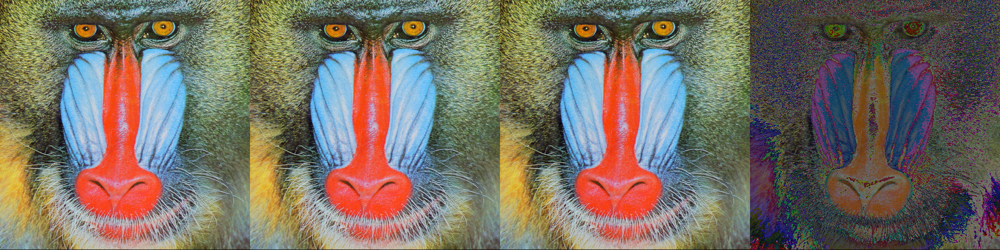

In [ ]:
side_to_side = np.hstack((image, image_1st_bit, image_3_bits, image_8th_bit))
cv2_imshow(side_to_side)

A imagem acima mostra em sequência da esquerda para a direta:
1. A imagem original.
2. A imagem original após zerar o primeiro bit menos significativo.
3. A imagem original após zerar até o terceiro bit menos significativo.
4. A imagem original após zerar o bit mais significativo.

É possível notar fácilmente a adulteração da imagem quando alteramos o bit mais significativo. Porém, alterando-se apenas os 3 planos de bits menos significativos, é bastante difícil detecatar alguma diferença. Desse modo, podemos utilizar tais planos de bits para ocultar uma mensagem, implementando a técnica de esteganografia escondendo até $ (512 * 512 * 3) / (8 * 1024) = 96 $ KB sem que o olho humano seja capaz de perceber a adulteração.

### Ocultando uma imagem em outra

A primeira aplicação da técnica de esteganografia será a ocultação de uma imagem em outra. Para tal. iremos utilizar os bits menos significativos de cada pixel da imagem recipiente para esconder os bits mais significativos de cada pixel da imagem mensagem.

Ou seja, é uma abordagem de esteganografia com perda de informação, visto que ignoramos os bits menos significativos da imagem mensagem.

É importante notar que temos por objetivo maximizar a compatbilidade entre as imagens, de maneira que imagens de dimensões diferentes podem ser utilizadas, desde que compartilhem o tipo de dado (numpy dtype) e o formato de imagem (rgb, etc).

#### Estaganografador

O princípio por trás do algoritmo é utilizar operações lógica e de translação de bits para inserir os bits mais significativos da imagem mensagem no lugar dos bits menos significativos da imagem recipiente.

Mais formalmente:

Dada uma imagem recipiente A, de NxM pixels e 3 canais de cores, na qual, para cada canal de cor, $a_{1,2}^{0}$ indica o bit 0 do pixel na linha 1 e coluna 2.

Dada uma imagem mensagem B, de OxP pixels e 3 canais de cores, na qual, para cada canal de cor, $b_{5,8}^{3}$ indica o bit 3 do pixel na linha 5 e coluna 8.

Então o algoritmo de codificação consiste em:

1. Redimensionar a imagem B para as mesmas dimensões da imagem A (NxM em 3 canais) utilizando interpolação na relação pixel/área, gerando a imagem C.
2. Transladar os n bits mais significativos de cada pixel da imagem C para as n posições menos significativas, zerando os demais bits, gerando a imagem D.
3. Zerar os n bits menos significativos da imagem A, gerando a imagem E.
4. Calcular a disjunção bit a bit das imagens D e E, gerando a imagem codificada F.

Dessa forma, para todo canal de cor e para todo 0 <= i < N, 0 <= j < M:

$f_{i,j}^{b} = d_{i,j}^{b} = c_{i,j}^{b + 8 - n}$ caso $b < n$

$f_{i,j}^{b} = a_{i,j}^{b} = e_{i,j}^{b}$ caso $b >= n$

Para efeitos deste trabalho, o redimensionamento que mapeia a imagem B na imagem C é entendido como uma caixa preta fornecida pelo pacote cv2.

Para decodificar a mensagem, basta extrair os n bits menos significativos da image codificada, transladá-los 8 - n bits para a esquerda e obter a imagem mensagem redimensionada e com menos profundidade (perda de informação).

In [ ]:
class ImgInImgSteganography:
    def __init__(self, nbits: int):
        self.nbits = nbits

    def _prepare_message(self, message: npt.NDArray, shape: tuple[int, ...]) -> npt.NDArray:
        # resize image to desired shape
        resized = cv2.resize(message, shape[:2], interpolation=cv2.INTER_AREA)

        # select only nbits most significative bits
        dtype = resized.dtype
        dtype_nbits = dtype.itemsize * 8
        mask_value =  (2 ** dtype_nbits) - (2 ** (dtype_nbits - self.nbits))
        mask = np.full(shape=shape, fill_value=mask_value, dtype=dtype)
        selected = resized & mask

        # shift nbits most significative bits to less significative positions
        shift = dtype.itemsize * 8 - self.nbits
        shifted = selected >> shift

        return shifted

    def _prepare_recipient(self, recipient: npt.NDArray) -> npt.NDArray:
        # select most significative bits except nbits less significative bits
        dtype = recipient.dtype
        mask_value = (2 ** (dtype.itemsize * 8)) - (2 ** self.nbits)
        mask = np.full(shape=recipient.shape, fill_value=mask_value, dtype=dtype)
        selected = recipient & mask

        return selected

    def encode(self, recipient: npt.NDArray, message: npt.NDArray) -> npt.NDArray:
        assert recipient.dtype == message.dtype
        merge_message = self._prepare_message(message, recipient.shape)
        merge_recipient = self._prepare_recipient(recipient)

        return merge_recipient | merge_message

    def decode(self, image: npt.NDArray) -> npt.NDArray:
        # select message bits
        dtype = image.dtype
        dtype_nbits = dtype.itemsize * 8
        mask_value =  2 ** self.nbits - 1
        mask = np.full(shape=image.shape, fill_value=mask_value, dtype=dtype)
        selected = image & mask

        # shift message back
        shift = dtype_nbits - self.nbits
        shifted = selected << shift

        return shifted

#### Imagens para teste

In [ ]:
recipient = cv2.imread("/content/drive/MyDrive/MC920/T1/baboon.png", cv2.IMREAD_COLOR)

print(f"Recipient image shape: {recipient.shape}")
print(f"Recipient image dtype: {recipient.dtype}")

message1 = cv2.imread("/content/drive/MyDrive/MC920/T1/monalisa.png", cv2.IMREAD_COLOR)
message2 = cv2.imread("/content/drive/MyDrive/MC920/T1/iris1.jpg", cv2.IMREAD_COLOR)
message3 = cv2.imread("/content/drive/MyDrive/MC920/T1/peppers.png", cv2.IMREAD_COLOR)
message4 = cv2.imread("/content/drive/MyDrive/MC920/T1/watch.png", cv2.IMREAD_COLOR)

print(f"Messages image shapes: {message1.shape, message2.shape, message3.shape, message4.shape}")
print(f"Messages image dtypes: {message1.dtype, message2.dtype, message3.dtype, message4.dtype}")

Recipient image shape: (512, 512, 3)
Recipient image dtype: uint8
Messages image shapes: ((256, 256, 3), (768, 1024, 3), (512, 512, 3), (768, 1024, 3))
Messages image dtypes: (dtype('uint8'), dtype('uint8'), dtype('uint8'), dtype('uint8'))


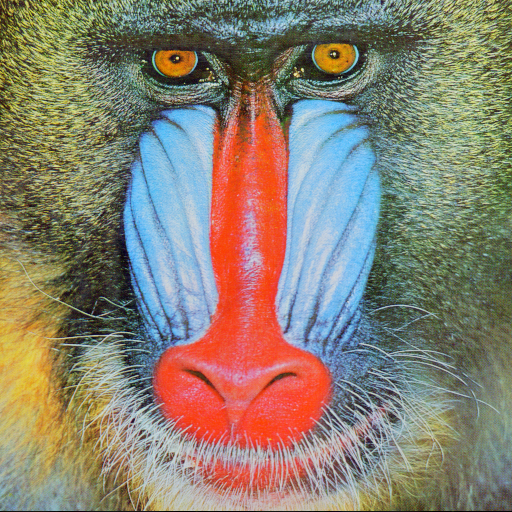

In [ ]:
cv2_imshow(recipient)

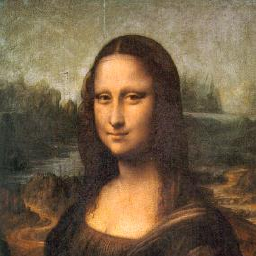

In [ ]:
cv2_imshow(message1)

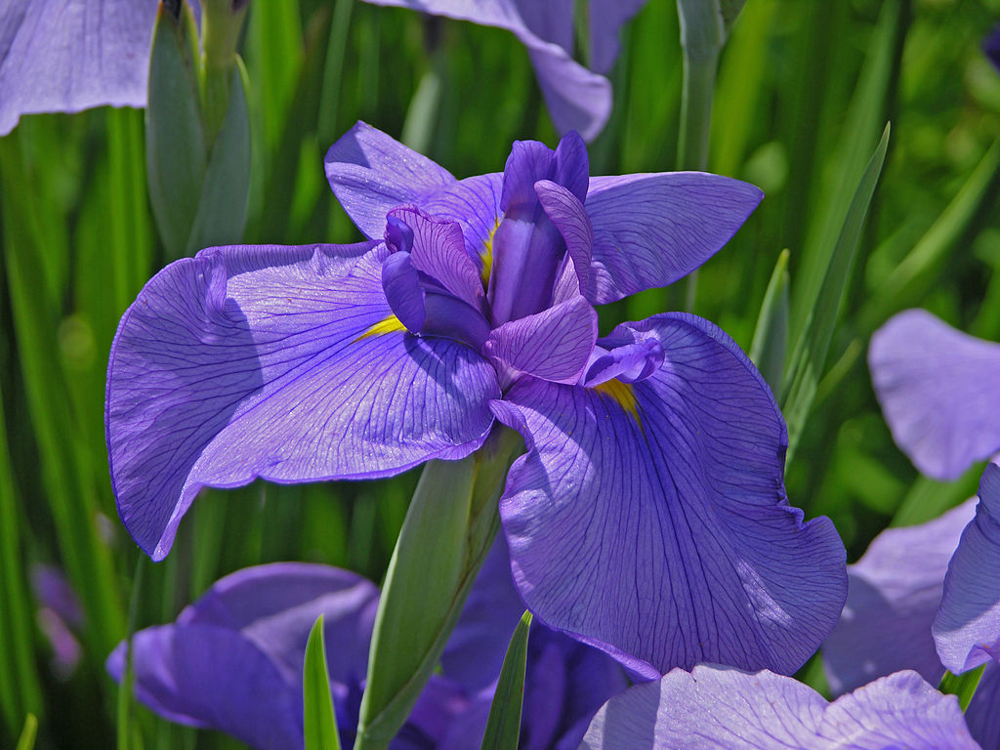

In [ ]:
cv2_imshow(message2)

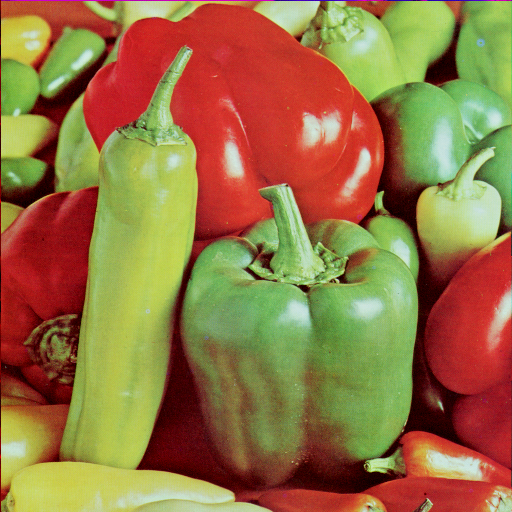

In [ ]:
cv2_imshow(message3)

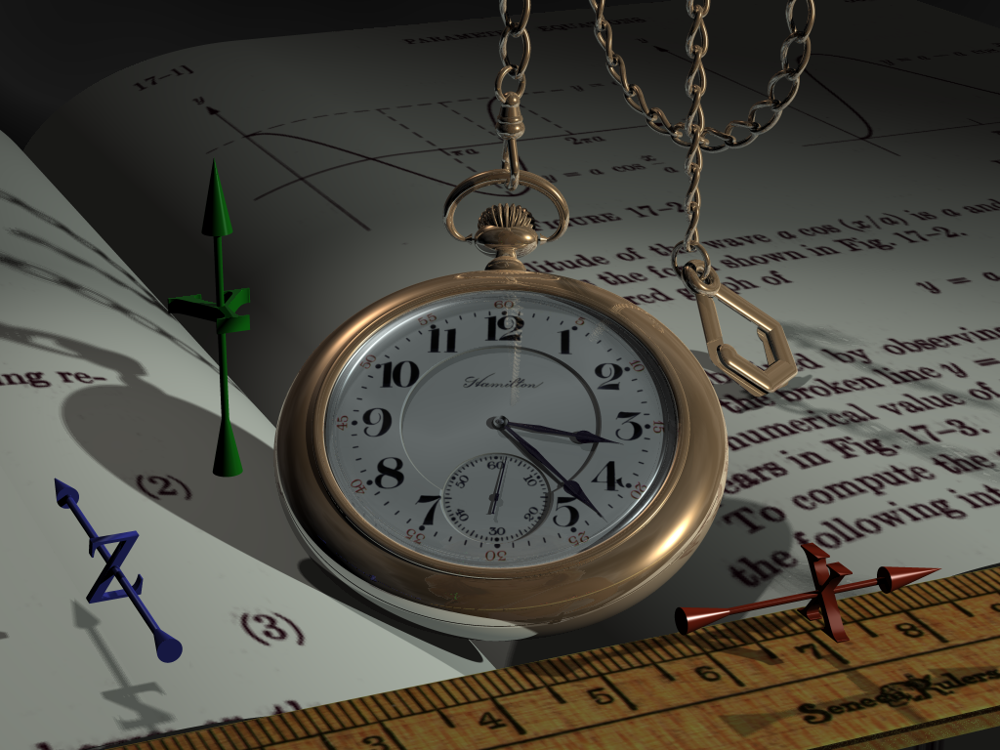

In [ ]:
cv2_imshow(message4)

#### Testes

In [ ]:
steganographer = ImgInImgSteganography(nbits=3)

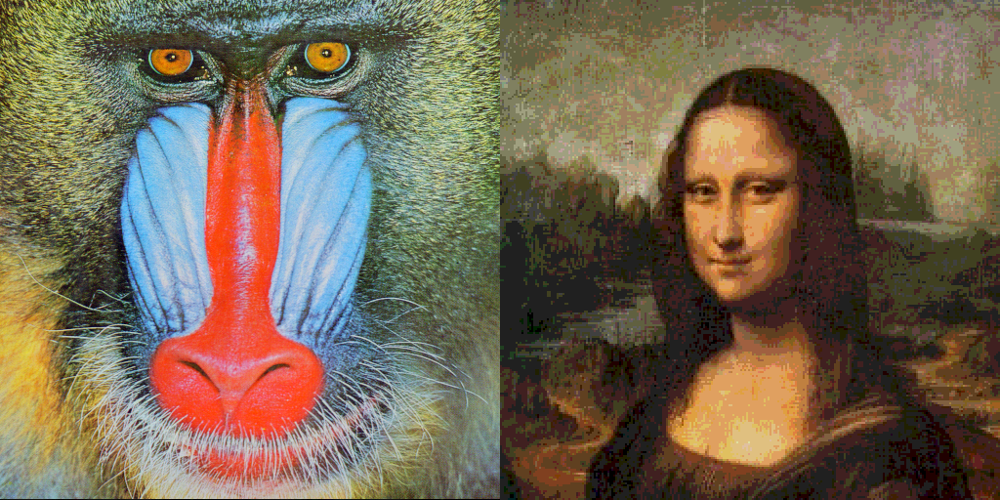

In [ ]:
encoded = steganographer.encode(recipient, message1)
decoded = steganographer.decode(encoded)

side_to_side = np.hstack((encoded, decoded))
cv2_imshow(side_to_side)

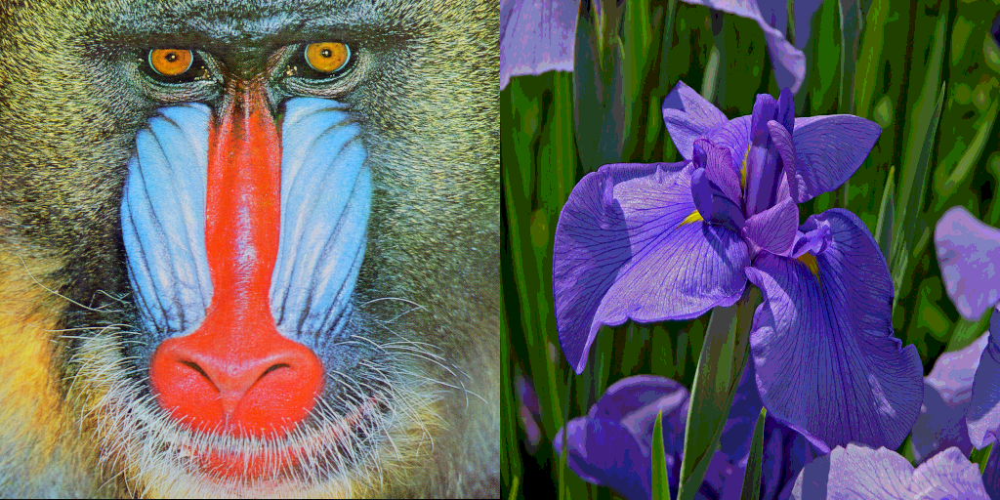

In [ ]:
encoded = steganographer.encode(recipient, message2)
decoded = steganographer.decode(encoded)

side_to_side = np.hstack((encoded, decoded))
cv2_imshow(side_to_side)

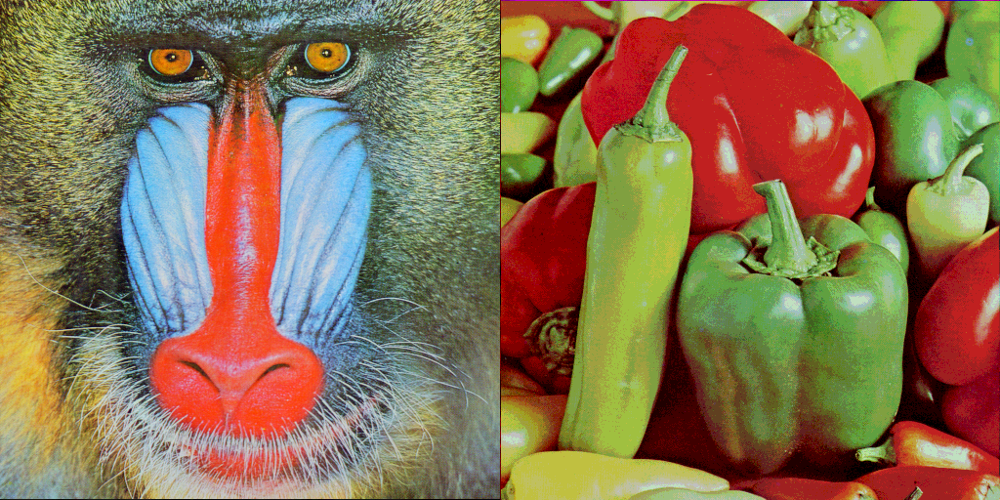

In [ ]:
encoded = steganographer.encode(recipient, message3)
decoded = steganographer.decode(encoded)

side_to_side = np.hstack((encoded, decoded))
cv2_imshow(side_to_side)

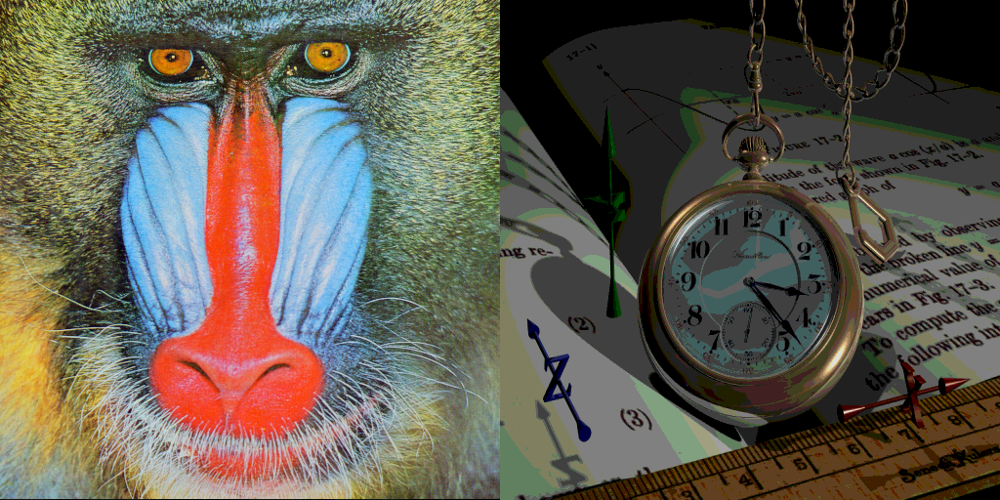

In [ ]:
encoded = steganographer.encode(recipient, message4)
decoded = steganographer.decode(encoded)

side_to_side = np.hstack((encoded, decoded))
cv2_imshow(side_to_side)

Nos experimentos acima, vemos:
À esquerda, a imagem mensagem (monalisa) ocultada em uma imagem recipiente (babuíno). À direita, a mensagem decodificada. Note que há perda de informação, mas os resultados ainda são bastante interessantes, gerando imagens com muitos detalhes.

### Ocultando texto em uma imagem

A segunda aplicação da técnica de esteganografia será a ocultação de uma imagem em outra. Para tal, iremos utilizar apenas um plano de bits, entre os menos significativos de cada pixel, da imagem recipiente para esconder a mensagem.

Ou seja, neste caso limitaremos o tamanho máximo da mensagem de maneira a evitar perda de informação.

#### Esteganografador

O princípio por trás do algoritmo é linearizar a imagem recipiente, utilizar operações lógicas de bits para inserir os bits mensagem no lugar dos bits menos significativos da imagem recipiente linearizada e reformatar a imagem para o formato original.

Mais formalmente:

Dada uma imagem recipiente A, de NxM pixels e 3 canais de cores, na qual $a_{1,2,3}^{0}$ indica o bit 0 do pixel na linha 1, coluna 2 e canal de cor 0.

Dada a mensagem B, uma string de K caracterces ASCII, no qual $a_{1}^{4}$ indica o bit 4 do caractere 1.

Dado um plano de bits 0 <= n <= 7.

Então o algoritmo de codificação consiste em:

1. Codificar a mensagem B para binário ASCII, gerando a mensagem C.

2. Extrair um vetor de bits D a partir dos bits da mensagem C, transladando o cada bit para a posição n.

    $d_{i + n}=c_{i // 8}^{i \\% 8}$

3. Construir um vetor de bits E, de tamanho 32, que representa o tamanho da mensagem em bits, transladando o cada bit para a posição n. Ou seja, um cabeçalho para armazenar o tamanho do vetor D.

4. Linearizar a imagem A, empilhando canais de cores e colunas, gerando o vetor F.

    $ B = np.reshape(A, N * M * 3) $

5. Criar um vetor mensagem G que concatena o vetor E, o vetor D e completa as posições faltantes para atingir o tamanho do vetor F com zeros.

6. Gerar o vetor recipient H a partir de F zerando o bit n.

7. Calcular a disjunção bit a bit dos vetors G e H, gerando o vetor codificado I.

8. Redimensionar o vetor I para as dimensões originais da imagem recipiente, gerando a imagem codificada J.

Dessa forma, para todo 0 <= x < N, 0 <= y < M:

$j_{x,y,c}^{b} = a_{x,y,c}^{b}$ caso $b \neq n$

$j_{x,y,c}^{b} = e_{x * M * 3 + 3 * y + c}^{b} $ caso $b = n$ e $x * M * 3 + 3 * y + c < 32$

$j_{x,y,c}^{b} = d_{x * M * 3 + 3 * y + c - 32}^{b} $ caso $b = n$ e $32 <= x * M * 3 + 3 * y + c < 32 + K * 8 $

$j_{x,y,c}^{b} = a_{x,y,c}^{b}$ caso $b = n$ e $x * M * 3 + 3 * y + c >= 32 + K * 8 $

Para decodificar a mensagem a partir da imagem codificada, basta relinearizar a mensagem, extrair os primeiros 32 primeiros bits na posição n para determinar o valor de K * 8, extrair os próximos K * 8 bits na posição n para obter o conteúdo da mensagem, converter o vetor de bits para bytes e converter os bytes para string.

In [ ]:
DTYPE = np.uint8
DTYPE_MAX = np.iinfo(np.uint8).max


class TxtInImgSteganography:
    """
    Steganographer to hide text in images.

    The main algorithm consists in bitwise operating linearized image numpy ndarrays.
    NOTE: Required interface matches numpy and cv2.
    """

    def __init__(self, bit_layer: int = 0):
        self.bit_layer = bit_layer
        self.bit_layer_value = 2**bit_layer
        self.header_dtype = np.uint32
        self.header_size = 32  # 4 bytes is more than enough for 4k images

    def _unpackbits_32_to_8(self, array: npt.NDArray) -> npt.NDArray:
        """Extends np.unpackbits for np.uint32 input array."""
        # TODO: test other byteorders
        return np.unpackbits(array.view(DTYPE)[::-1])

    def _prepare_message(self, message: str, shape: tuple[int, ...]) -> npt.NDArray:
        """
        Prepare message mask for steganography.

        Message mask will be merged with recipient image through bitwise or.
        """
        linear_shape = np.prod(shape)

        assert (
            len(message) * 8 <= linear_shape - self.header_size
        ), "Given `message` is too big for the image. Try another combination!"
        # encode message to ascii
        encoded_message = message.encode("ascii", "ignore")
        bitarray_message = (
            np.unpackbits(np.frombuffer(encoded_message, dtype=DTYPE)) << self.bit_layer
        )
        message_size = bitarray_message.shape[0]

        # create header with content size
        bitarray_header = (
            self._unpackbits_32_to_8(np.array([message_size], dtype=self.header_dtype))
            << self.bit_layer
        )

        content_size = message_size + self.header_size

        linear_message_mask = np.hstack(
            (
                bitarray_header,
                bitarray_message,
                np.zeros(shape=(linear_shape - content_size), dtype=DTYPE),
            )
        )
        # For i < content_size:
        #   0,0,0,0,0,0,0,b7 if self.bit_layer == 0
        #   0,0,0,0,0,0,b6,0 if self.bit_layer == 1
        #   ...
        #   b1,0,0,0,0,0,0,0 if self.bit_layer == 7
        # For i >= content_size: 0,0,0,0,0,0,0,0

        return linear_message_mask, content_size

    def _prepare_recipient(
        self, recipient: npt.NDArray, content_size: int
    ) -> npt.NDArray:
        """
        Prepare recipient mask for steganography.

        Recipient mask will be merged with message image through bitwise or.
        """
        linear_recipient = np.reshape(recipient, -1)
        content_mask = np.hstack(
            (
                np.full(
                    content_size, DTYPE_MAX - self.bit_layer_value, dtype=DTYPE
                ),  # DTYPE_MAX - 1 -> 11111110
                np.full(
                    linear_recipient.shape[0] - content_size, DTYPE_MAX, dtype=DTYPE
                ),  # DTYPE_MAX -> 11111111
            )
        )

        linear_recipient_mask = np.where(
            content_mask == DTYPE_MAX - self.bit_layer_value,
            content_mask & linear_recipient,  # b0,b1,b2,b3,b4,b5,b6,0
            linear_recipient,  # b0,b1,b2,b3,b4,b5,b6,b7
        )

        return linear_recipient_mask

    def encode(self, recipient: npt.NDArray, message: str) -> npt.NDArray:
        """Encode message into recipient image using steganography algorithm."""
        linear_message_mask, content_size = self._prepare_message(
            message, recipient.shape
        )
        # For i < content_size: 0,0,0,0,0,0,0,y7
        # For i >= content_size: 0,0,0,0,0,0,0,0

        linear_recipient_mask = self._prepare_recipient(recipient, content_size)
        # For i < content_size: x0,x1,x2,x3,x4,x5,x6,0
        # For i >= content_size: x0,x1,x2,x3,x4,x5,x6,x7

        linear_image = linear_recipient_mask | linear_message_mask
        # For i < content_size:
        # x0,x1,x2,x3,x4,x5,x6,0  | 0,0,0,0,0,0,0,y7 = x0,x1,x2,x3,x4,x5,x6,y7
        # For i >= content_size:
        # x0,x1,x2,x3,x4,x5,x6,x7 | 0,0,0,0,0,0,0,0  = x0,x1,x2,x3,x4,x5,x6,x7

        return np.reshape(linear_image, recipient.shape)

    def decode(self, image: npt.NDArray) -> npt.NDArray:
        """Decode message from given image using steganography algorithm."""
        linear_image = np.reshape(image, -1)
        bit_mask_1 = np.full(linear_image.shape[0], self.bit_layer_value, dtype=DTYPE)
        content_bitarray = linear_image & bit_mask_1
        content_bitarray = content_bitarray >> self.bit_layer

        message_size = BitArray(content_bitarray[: self.header_size]).uint
        message = BitArray(
            content_bitarray[self.header_size : self.header_size + message_size]
        ).bytes.decode("ascii")

        return message

#### Mensagens para teste

In [ ]:
message1 = "Uma mensagem bem simples!"

In [ ]:
message2 = """
Lorem ipsum dolor sit amet, consectetur adipiscing elit. In sit amet justo pulvinar mauris commodo interdum. Pellentesque habitant morbi tristique senectus et netus et malesuada fames ac turpis egestas. Praesent tincidunt turpis vitae nulla varius porttitor. Quisque et consectetur neque. In hac habitasse platea dictumst. Curabitur a metus leo. Sed mattis vehicula dui, eu commodo tortor laoreet nec. Ut fermentum felis vitae tempus pretium. Aenean augue est, aliquet eget pretium sed, imperdiet ut justo. Quisque sodales nisl et nibh facilisis congue.

Morbi quis dui pulvinar, suscipit ex eget, pellentesque nisl. Suspendisse ut ante et diam maximus euismod nec a ante. Vivamus vel suscipit tortor. Phasellus maximus libero tortor, sit amet commodo eros gravida eu. Orci varius natoque penatibus et magnis dis parturient montes, nascetur ridiculus mus. Curabitur fermentum, ipsum nec viverra aliquam, turpis purus faucibus risus, et varius libero felis non ligula. Pellentesque vehicula finibus tortor vitae ornare.

Vestibulum eleifend vel purus ut venenatis. Nulla volutpat lobortis sapien, ullamcorper rhoncus sapien porttitor sed. Proin urna elit, venenatis vitae dolor ut, volutpat lacinia diam. Proin scelerisque lacus a mattis semper. Quisque tristique posuere tellus nec pretium. Nam auctor lobortis metus a imperdiet. Curabitur vel erat sit amet mi tempus iaculis. Phasellus non euismod tortor. Nam sapien metus, mattis ut aliquam eget, elementum dignissim magna. Sed varius felis vel risus vestibulum ultrices. Sed enim libero, placerat in tristique in, interdum et sem. Nunc sollicitudin non nisl sit amet tempus. Donec magna nibh, tincidunt ac iaculis eget, interdum non odio. Aenean eu massa quam.

Duis aliquet elit non justo gravida placerat. Phasellus vel sodales lorem. Vestibulum nulla nunc, semper vitae facilisis eget, aliquet id dolor. Vestibulum libero tortor, ultricies malesuada ipsum vitae, gravida feugiat velit. Nullam sed metus a magna tristique vulputate ut commodo ante. Cras tincidunt mauris non purus ultrices auctor. Donec ac sagittis mauris, vel facilisis ligula. Nam efficitur ante sed viverra faucibus. Suspendisse augue nisl, tincidunt et tellus nec, commodo blandit est. Nullam at justo vulputate, eleifend metus vehicula, vulputate lorem. Duis mattis, enim quis rhoncus tincidunt, nunc est elementum libero, vel accumsan metus arcu a ligula. Fusce eu libero velit. Curabitur lobortis ipsum vitae convallis vestibulum. Proin tempor non magna eget tincidunt. In nisi urna, egestas nec bibendum eget, lobortis nec felis.

Fusce sit amet sagittis dolor, vel euismod mauris. Nam et congue quam. Donec hendrerit commodo enim, non semper neque congue eu. Phasellus imperdiet nisl sit amet eros vehicula dignissim. Fusce vel faucibus tellus. Nulla vitae mollis mi. Vestibulum dolor purus, tincidunt sodales condimentum et, consequat in leo. Etiam aliquet dapibus ex ac dictum. Mauris auctor feugiat imperdiet.
"""

In [ ]:
with open("/content/drive/MyDrive/MC920/T1/coldplay_discography.txt") as f:
    message3 = f.read()

print(len(message3))

print("*"*35)
print("\nINICIO\n")
print(message3[:100])
print("*"*35)
print(message3[-100:])
print("\nFIM")
print("*"*35)

149015
***********************************

INICIO

PARACHUTES

Don't Panic

Bones, sinking like stones,
All that we fought for,
Homes, places we've gro
***********************************
meone like you to remain so sure
And in a chain reaction
I dissolve and break and then away I crawl.

FIM
***********************************


#### Testes

In [ ]:
def experiment(steganografer: TxtInImgSteganography, image: npt.NDArray, message: str) -> None:
    encoded = steganographer.encode(image, message)
    decoded = steganographer.decode(encoded)

    side_to_side = np.hstack((image, encoded))
    cv2_imshow(side_to_side)

    print("*"*35)
    print("INICIO\n")
    print(decoded[:100])
    print("*"*35)
    print(decoded[-100:])
    print("\nFIM")
    print("*"*35)

##### Bit 0

In [ ]:
steganographer = TxtInImgSteganography(0) # 0,0,0,0,0,0,0,1

In [ ]:
image = cv2.imread("/content/drive/MyDrive/MC920/T1/watch.png", cv2.IMREAD_COLOR)

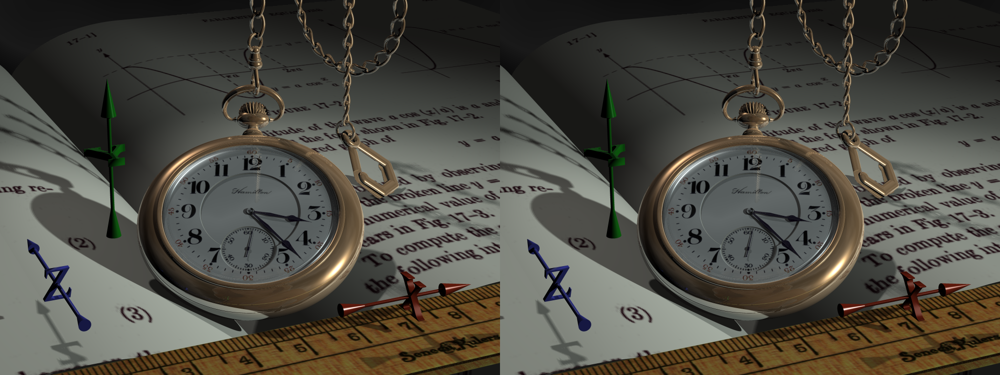

***********************************
INICIO

Uma mensagem bem simples!
***********************************
Uma mensagem bem simples!

FIM
***********************************


In [ ]:
experiment(steganographer, image, message1)

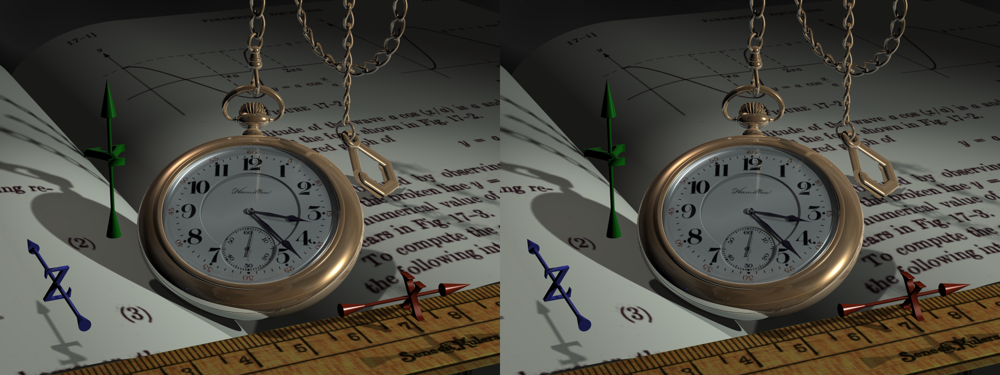

***********************************
INICIO


Lorem ipsum dolor sit amet, consectetur adipiscing elit. In sit amet justo pulvinar mauris commodo 
***********************************
dimentum et, consequat in leo. Etiam aliquet dapibus ex ac dictum. Mauris auctor feugiat imperdiet.


FIM
***********************************


In [ ]:
experiment(steganographer, image, message2)

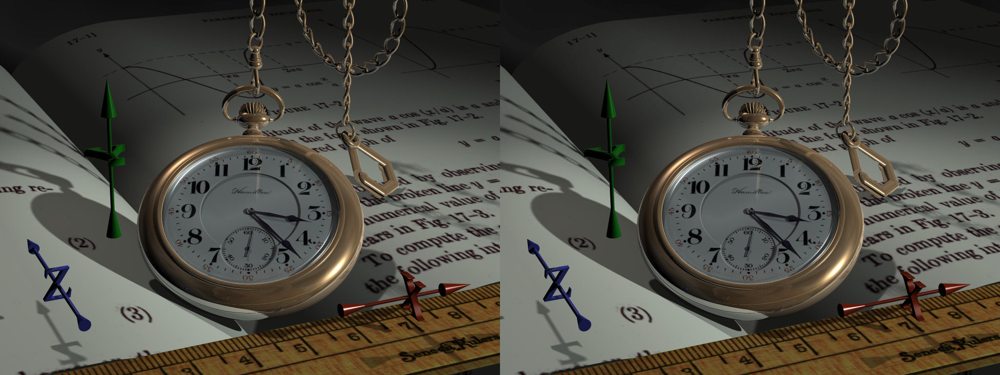

***********************************
INICIO

PARACHUTES

Don't Panic

Bones, sinking like stones,
All that we fought for,
Homes, places we've gro
***********************************
meone like you to remain so sure
And in a chain reaction
I dissolve and break and then away I crawl.

FIM
***********************************


In [ ]:
experiment(steganographer, image, message3)

Nos experimentos acima, é exibido primeiro uma colagem da imagem original (à esquerda) com a imagem que contém uma mensagem codificada (à direita). Em sequência, exibimos os primeiros 100 caracteres e os últimos 100 caracteres da mensagem decodificada com o objetivo de garantir que não há perda de informação.

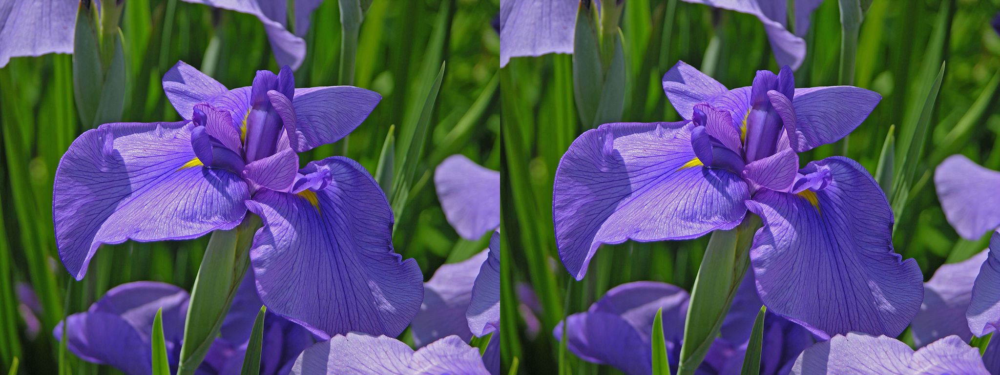

***********************************
INICIO

PARACHUTES

Don't Panic

Bones, sinking like stones,
All that we fought for,
Homes, places we've gro
***********************************
meone like you to remain so sure
And in a chain reaction
I dissolve and break and then away I crawl.

FIM
***********************************


In [ ]:
image2 = cv2.imread("/content/drive/MyDrive/MC920/T1/iris1.jpg", cv2.IMREAD_COLOR)

experiment(steganographer, image2, message3)

A conclusão é de que utilizando apenas o bit menos significativo, a olho nu, sem comparar minuciosamente com a imagem original, não é notável nenhuma diferença com relação a imagem codificada e a mensagem é transmitida sem prejuízos. Porém, se percebermos a região superior esquerda da folha direita na imagem do relógio, percebemos a formação de um gradiente. Esse efeito não foi observado em experimentos com outras imagens como a da iris. Portanto, pode-se levantar a hipótese de que a imagem do relógio foi construída sintéticamente para este fim.

##### Bit 7

In [ ]:
steganographer = TxtInImgSteganography(7) # 1,0,0,0,0,0,0,0

In [ ]:
image = cv2.imread("/content/drive/MyDrive/MC920/T1/watch.png", cv2.IMREAD_COLOR)

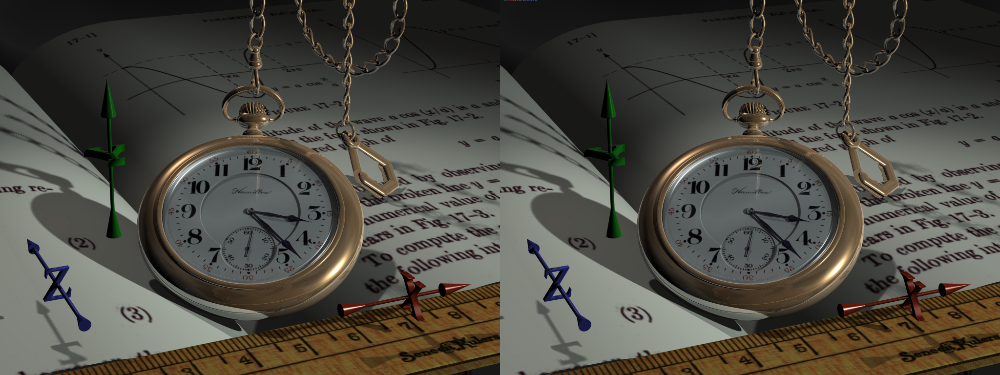

***********************************
INICIO

Uma mensagem bem simples!
***********************************
Uma mensagem bem simples!

FIM
***********************************


In [ ]:
experiment(steganographer, image, message1)

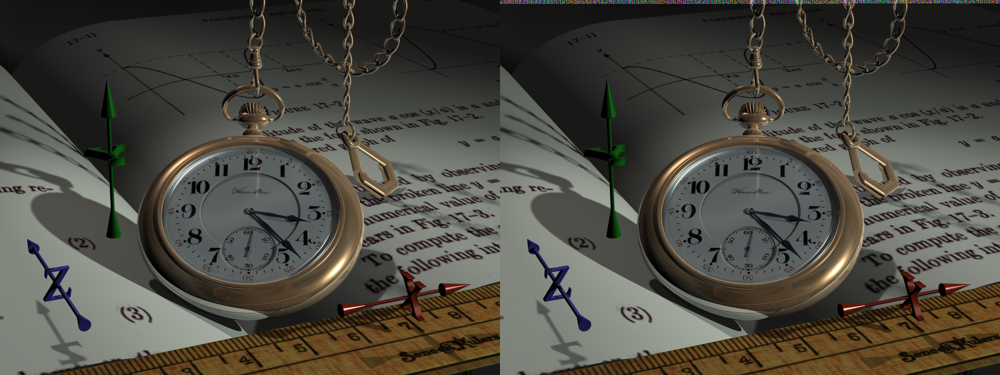

***********************************
INICIO


Lorem ipsum dolor sit amet, consectetur adipiscing elit. In sit amet justo pulvinar mauris commodo 
***********************************
dimentum et, consequat in leo. Etiam aliquet dapibus ex ac dictum. Mauris auctor feugiat imperdiet.


FIM
***********************************


In [ ]:
experiment(steganographer, image, message2)

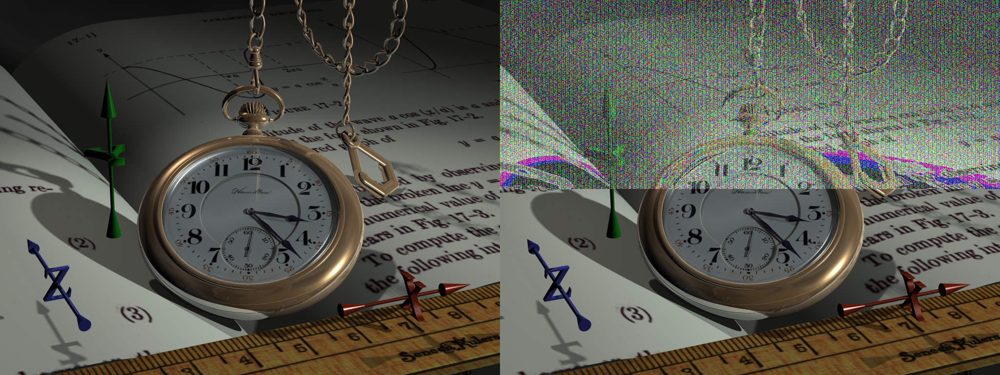

***********************************
INICIO

PARACHUTES

Don't Panic

Bones, sinking like stones,
All that we fought for,
Homes, places we've gro
***********************************
meone like you to remain so sure
And in a chain reaction
I dissolve and break and then away I crawl.

FIM
***********************************


In [ ]:
experiment(steganographer, image, message3)

A conclusão já esperada deste experimento é que utilizar o bit mais significativo da imagem impacta muito na imagem percebida pelo olho, de maneira que não é uma abordagem boa o suficiente para implementar a técnica de esteganografia, que depende da imperceptibilidade da adulteração da imagem original.

##### Bits 0-6

A fim de delimitar o bit mais significativo que não causa interferências visíveis, testaremos cada um deles:

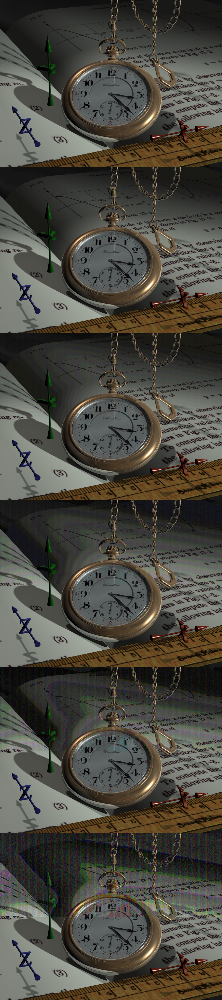

In [ ]:
comparison = image
for i in range(1,6):
    steganographer = TxtInImgSteganography(i)
    encoded = steganographer.encode(image, message3)
    comparison = np.vstack((comparison, encoded))

cv2_imshow(comparison)

Acima vemos, de cima para baixo, a imagem original, a imagem codificada utilizando o 2 bit menos significativo, o terceiro bit menos significativo e assim por diante.

Um olhar atento já é capaz de perceber a adulteração a partir do 2º bit menos significativo, porém um olhar desatento já seria suficiente para notar a partir do 3º bit menos significativo (plano de bits 2), pois a região de livro logo acima do relógio fica bastante aparente. Possívelmente uma mensagem que cobrisse toda a imagem não levaria a tamanho estranhamento visual.

Agora, com o objetivo de perceber com mais detalhes o efeito gerado pela codificação da mensagem, iremos codificar a mensagem na imagem da iris e analisar apenas o recorte no qual as diferenças são mais notáveis:

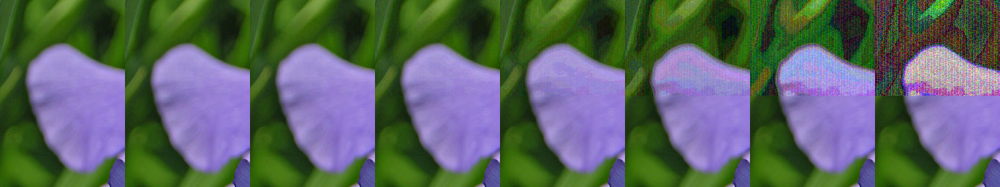

In [ ]:
image2 = cv2.imread("/content/drive/MyDrive/MC920/T1/iris1.jpg", cv2.IMREAD_COLOR)
comparison = image2[image2.shape[0]//3:2*image2.shape[0]//3, 5*image2.shape[1]//6:, :]
for i in range(0,7):
    steganographer = TxtInImgSteganography(i)
    encoded = steganographer.encode(image2, message3)
    comparison = np.hstack((comparison, encoded[image2.shape[0]//3:2*image2.shape[0]//3, 5*image2.shape[1]//6:, :]))

cv2_imshow(comparison)

É possível perceber a adulteração, com um olhar atento, a partir do plano de bits 2, porém a partir do plano de bits 3 fica escancarada a diferença.